# Wine Classifications by Reviews

There's so many wines out there today, and often times a trip to the grocery store to pick up a quick drink to go with dinner can take longer than expected. Even when you know the type of wine you like, there's so many different wineries, and let's not even start on the years. Even wanting to try something new can be daunting, what if you spend $15 dollars just to find out you can't stand more than one sip?! 

Luckily, there's sommeliers in the world... unluckily, they probably aren't hanging around your local grocery or liquor store. Classification beyond the wine types could prove valuable in this case! Using machine learning and hefty data source of sommelier's reviews, I plan to use **LSA** text classification to find groups of wine, possibly with more in common than just being the same type!

## EDA

Before we can begin text classification, we need to get a better understanding of the data we are working with. Our data set ultimately comes from the Wine Enthuisiast website, which was scraped by the Kaggle user zackthoutt **(add apa reference)**.

In [1]:
import pandas as pd

#data from https://www.kaggle.com/zynicide/wine-reviews/version/4#winemag-data_first150k.csv

We can start by importing our previously downloaded dataset, and just taking a look at what we have to work with. 

In [2]:
wine=pd.read_csv("D:\Practicum2\data\winemag_data.csv")

In [3]:
wine.head()

,Unnamed: 0,country,description,designation,points,price,province,region_1,region_2,variety,winery
0,0,US,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235.0,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz
1,1,Spain,"Ripe aromas of fig, blackberry and cassis are ...",Carodorum Selección Especial Reserva,96,110.0,Northern Spain,Toro,NaN,Tinta de Toro,Bodega Carmen Rodríguez
2,2,US,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90.0,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley
3,3,US,"This spent 20 months in 30% new French oak, an...",Reserve,96,65.0,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi
4,4,France,"This is the top wine from La Bégude, named aft...",La Brûlade,95,66.0,Provence,Bandol,NaN,Provence red blend,Domaine de la Bégude


We can see right away one of our headers is a bit oddly labelled, so to make it easier to refer to this row id later, let's go ahead and rename it. 

In [4]:
list(wine)

['Unnamed: 0',
 'country',
 'description',
 'designation',
 'points',
 'price',
 'province',
 'region_1',
 'region_2',
 'variety',
 'winery']

In [5]:
wine.rename(columns={'Unnamed: 0':'id'}, inplace=True)

In [6]:
wine.head()

,id,country,description,designation,points,price,province,region_1,region_2,variety,winery
0,0,US,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235.0,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz
1,1,Spain,"Ripe aromas of fig, blackberry and cassis are ...",Carodorum Selección Especial Reserva,96,110.0,Northern Spain,Toro,NaN,Tinta de Toro,Bodega Carmen Rodríguez
2,2,US,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90.0,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley
3,3,US,"This spent 20 months in 30% new French oak, an...",Reserve,96,65.0,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi
4,4,France,"This is the top wine from La Bégude, named aft...",La Brûlade,95,66.0,Provence,Bandol,NaN,Provence red blend,Domaine de la Bégude


While we will be using text classification with the description field specifically, it doesn't hurt to look at the other available. A quick describe function can give us a nice statistical summary. 

In [7]:
wine.describe()

,id,points,price
count,150930.000000,150930.000000,137235.000000
mean,75464.500000,87.888418,33.131482
std,43569.882402,3.222392,36.322536
min,0.000000,80.000000,4.000000
25%,37732.250000,86.000000,16.000000
50%,75464.500000,88.000000,24.000000
75%,113196.750000,90.000000,40.000000
max,150929.000000,100.000000,2300.000000


It's always important to check the data types as well, and make any neccesary transformations. Price is currently a float, which could cause issues with later analysis. 

In [8]:
wine.dtypes
#research confirms price is in USD

id               int64
country         object
description     object
designation     object
points           int64
price          float64
province        object
region_1        object
region_2        object
variety         object
winery          object
dtype: object

In [9]:
from decimal import Decimal

There are some nulls which could be contributing to the data type issue, so we can go ahead on fill this in. If we had planned on using the price column as a part of our classification model, we would want to be more careful with how we handle this, but for a cursory analysis, filling it in with zero won't be too much of an issue. 

In [10]:
wine['price'].isnull().values.any()

True

In [11]:
wine['price']=wine['price'].fillna(0)

In [12]:
wine['price'].isnull().values.any()

False

In [13]:
wine['price'] = wine['price'].apply(Decimal)

Well this might still look wrong, it actually has been converted (**add offcial source**). 

In [14]:
#looks wrong
wine.dtypes

id              int64
country        object
description    object
designation    object
points          int64
price          object
province       object
region_1       object
region_2       object
variety        object
winery         object
dtype: object

In [15]:
#but actually
#https://stackoverflow.com/questions/47266531/typeerror-conversion-from-series-to-decimal-is-not-supported
type(wine['price'].iloc[0])

decimal.Decimal

Now let's take a look at our geographic information. 

In [16]:
wine.groupby('country')['country'].count()

country
Albania                       2
Argentina                  5631
Australia                  4957
Austria                    3057
Bosnia and Herzegovina        4
Brazil                       25
Bulgaria                     77
Canada                      196
Chile                      5816
China                         3
Croatia                      89
Cyprus                       31
Czech Republic                6
Egypt                         3
England                       9
France                    21098
Georgia                      43
Germany                    2452
Greece                      884
Hungary                     231
India                         8
Israel                      630
Italy                     23478
Japan                         2
Lebanon                      37
Lithuania                     8
Luxembourg                    9
Macedonia                    16
Mexico                       63
Moldova                      71
Montenegro                    2


We need to rename a few countries to match the designations in our geo-json file (used below).

In [17]:
wine['country']=wine['country'].replace(to_replace ="US", value ="United States of America") 
wine['country']=wine['country'].replace(to_replace ="England", value ="United Kingdom") 
wine['country']=wine['country'].replace(to_replace ="Serbia", value ="Republic of Serbia") 
#just manually looked these up on geojson file below

And what does US-France mean for a country???

In [18]:
wine[wine['country']=='US-France']

,id,country,description,designation,points,price,province,region_1,region_2,variety,winery
144054,144054,US-France,"Defies categorization, in more ways than one. ...",NaN,88,50,Santa Barbara County-Condrieu,NaN,NaN,Viognier,Deux C


This appears to be the only wine with a combined country listed, so instead of adding into the pool of one country where it would technically be incorrectly labeled, and given the number of records, we are just going to drop it. The description also begins with "defies categorization" which just isn't promising for a classification model!

In [19]:
wine=wine.drop([144054])

In [20]:
wine

,id,country,description,designation,points,price,province,region_1,region_2,variety,winery
0,0,United States of America,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz
1,1,Spain,"Ripe aromas of fig, blackberry and cassis are ...",Carodorum Selección Especial Reserva,96,110,Northern Spain,Toro,NaN,Tinta de Toro,Bodega Carmen Rodríguez
2,2,United States of America,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley
3,3,United States of America,"This spent 20 months in 30% new French oak, an...",Reserve,96,65,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi
4,4,France,"This is the top wine from La Bégude, named aft...",La Brûlade,95,66,Provence,Bandol,NaN,Provence red blend,Domaine de la Bégude
...,...,...,...,...,...,...,...,...,...,...,...
150925,150925,Italy,Many people feel Fiano represents southern Ita...,NaN,91,20,Southern Italy,Fiano di Avellino,NaN,White Blend,Feudi di San Gregorio
150926,150926,France,"Offers an intriguing nose with ginger, lime an...",Cuvée Prestige,91,27,Champagne,Champagne,NaN,Champagne Blend,H.Germain
150927,150927,Italy,This classic example comes from a cru vineyard...,Terre di Dora,91,20,Southern Italy,Fiano di Avellino,NaN,White Blend,Terredora
150928,150928,France,"A perfect salmon shade, with scents of peaches...",Grand Brut Rosé,90,52,Champagne,Champagne,NaN,Champagne Blend,Gosset


We should also confirm there are no duplicate rows. Unfortunately it looks their are, so we will want to drop those so as not to unecessarily weight any further EDA or our text classification.

In [21]:
wine['description'].nunique()

97820

In [25]:
wine=wine.drop_duplicates(subset=['country','description','designation','points','price','province','region_1','region_2','variety','winery'],keep='first')

In [27]:
len(wine.index)

97850

Let's start analyzing by country, and we can create a summarized view to make that a little easier. 

In [28]:
winesumC=wine.groupby('country', as_index=False)[['id']].count()

In [29]:
winesumC['percent']=round((winesumC['id']/150929)*100,2)

In [30]:
winesumC

,country,id,percent
0,Albania,1,0.00
1,Argentina,3447,2.28
2,Australia,3152,2.09
3,Austria,1959,1.30
4,Bosnia and Herzegovina,3,0.00
5,Brazil,14,0.01
6,Bulgaria,56,0.04
7,Canada,149,0.10
8,Chile,3735,2.47
9,China,2,0.00


In [31]:
winesumC=winesumC.drop(columns=['id'])

Everyone loves a good map!! Unfortunately all of the other region data is highly specific to each country, and sometimes more of a wine region than a common geographically region, makig it difficult to map by anything other than country. **Add reference below**

In [32]:
#adapted from https://python-graph-gallery.com/292-choropleth-map-with-folium/
import json
import pandas as pd
import folium
import os

country_geo = os.path.join('D:\Practicum2', 'countries.geojson')
 
# Initialize the map:
m = folium.Map(location=[15, 29], zoom_start=2)
 
# Add the color for the chloropleth:
m.choropleth(
 geo_data=country_geo,
 name='choropleth',
 data=winesumC,
 columns=['country', 'percent'],
 key_on='properties.ADMIN',
 fill_color='YlOrRd',
 fill_opacity=0.7,
 line_opacity=0.2,
 legend_name='Percent (%)',
 threshold_scale=[0, 5, 10, 15, 45],
 nan_fill_color='lightgrey'
)
folium.LayerControl().add_to(m)
 

m
 

C:\Users\jelin\Anaconda3\lib\site-packages\folium\folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


Let's see how our other data breakdowns by the top 3 countries in this dataset: USA, Italy, and France. 

In [33]:
wine[(wine['country']=='United States of America') | (wine['country']=='Italy') | (wine['country']=='France')].groupby('country').agg({'id':pd.Series.nunique,'province':pd.Series.nunique,'region_1':pd.Series.nunique,'region_2':pd.Series.nunique,'designation':pd.Series.nunique,'variety':pd.Series.nunique,'winery':pd.Series.nunique,})

,id,province,region_1,region_2,designation,variety,winery
country,,,,,,,
France,14459,11,393,0,4542,131,2940
Italy,14850,10,371,0,5593,177,2571
United States of America,40544,24,265,18,11241,218,4761


We can also take a visual look at the summary statistics we looked at above, but this time without duplicates. 

In [36]:
import matplotlib.pyplot as plt

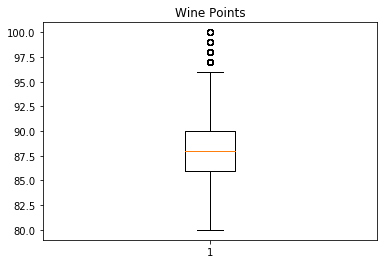

In [37]:
fig1, ax1 = plt.subplots()
ax1.set_title('Wine Points')
ax1.boxplot(wine['points'])
plt.show()

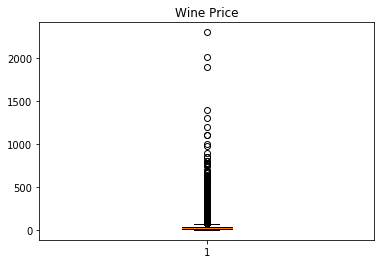

In [38]:
fig1, ax1 = plt.subplots()
ax1.set_title('Wine Price')
ax1.boxplot(wine['price'].apply(int))
plt.show()

Price has some outliers, so let's look at a view without those to get a better sense of the majority of the data. 

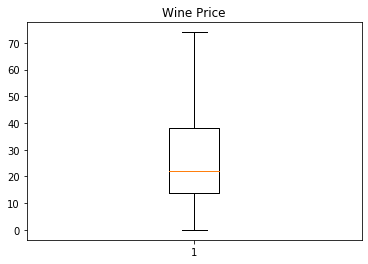

In [39]:
fig1, ax1 = plt.subplots()
ax1.set_title('Wine Price')
ax1.boxplot(wine['price'].apply(int), showfliers=False)
plt.show()

We can also take a look at this by our top 3 countries.

In [40]:
wineUS=wine[wine['country']=='United States of America']
wineIT=wine[wine['country']=='Italy']
wineFR=wine[wine['country']=='France']

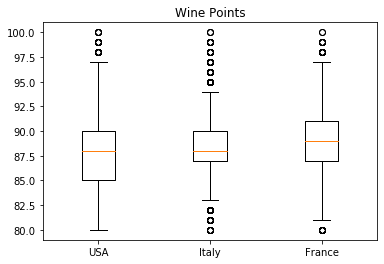

In [41]:
data_to_plot = [wineUS['points'], wineIT['points'], wineFR['points']]


fig1, ax1 = plt.subplots()
ax1.set_title('Wine Points')
ax1.set_xticklabels(['USA', 'Italy', 'France'])
ax1.boxplot(data_to_plot)
plt.show()

Here's the data for the numbers people as well:

In [42]:
wineUS['points'].describe()

count    40544.000000
mean        87.908766
std          3.392928
min         80.000000
25%         85.000000
50%         88.000000
75%         90.000000
max        100.000000
Name: points, dtype: float64

In [43]:
wineUS['price'].apply(int).describe()

count    40544.000000
mean        33.956714
std         26.060329
min          0.000000
25%         19.000000
50%         28.000000
75%         42.000000
max       2013.000000
Name: price, dtype: float64

In [44]:
wineIT['points'].describe()

count    14850.000000
mean        88.391178
std          2.735330
min         80.000000
25%         87.000000
50%         88.000000
75%         90.000000
max        100.000000
Name: points, dtype: float64

In [45]:
wineIT['price'].apply(int).describe()

count    14850.000000
mean        31.031178
std         37.336528
min          0.000000
25%         12.000000
50%         21.000000
75%         40.000000
max        900.000000
Name: price, dtype: float64

In [46]:
wineFR['points'].describe()

count    14459.000000
mean        88.918805
std          3.173987
min         80.000000
25%         87.000000
50%         89.000000
75%         91.000000
max        100.000000
Name: points, dtype: float64

In [47]:
wineFR['price'].apply(int).describe()

count    14459.000000
mean        31.634622
std         61.702389
min          0.000000
25%          0.000000
50%         18.000000
75%         36.000000
max       2300.000000
Name: price, dtype: float64

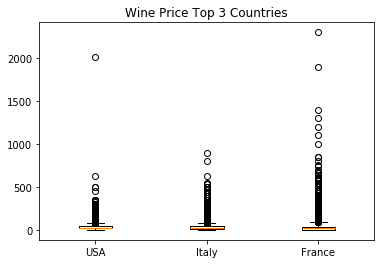

In [48]:
data_to_plot = [wineUS['price'].apply(int), wineIT['price'].apply(int), wineFR['price'].apply(int)]


fig1, ax1 = plt.subplots()
ax1.set_title('Wine Price Top 3 Countries')
ax1.set_xticklabels(['USA', 'Italy', 'France'])
ax1.boxplot(data_to_plot)
plt.show()

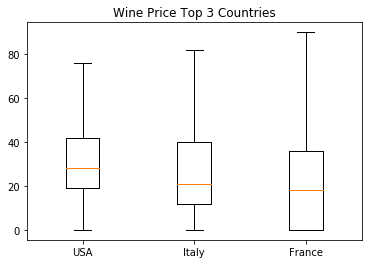

In [49]:
fig1, ax1 = plt.subplots()
ax1.set_title('Wine Price Top 3 Countries')
ax1.set_xticklabels(['USA', 'Italy', 'France'])
ax1.boxplot(data_to_plot, showfliers=False)
plt.show()

Maybe there is some correlation between the price and points? We can check quick!

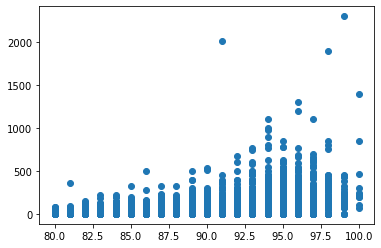

In [50]:
plt.scatter(wine['points'], wine['price'].apply(int))
plt.show()

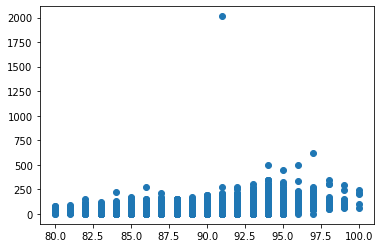

In [51]:
plt.scatter(wineUS['points'], wineUS['price'].apply(int))
plt.show()

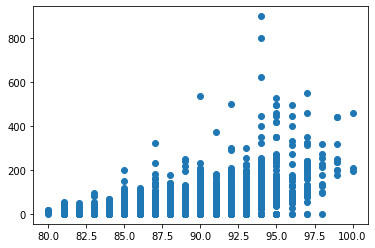

In [52]:
plt.scatter(wineIT['points'], wineIT['price'].apply(int))
plt.show()

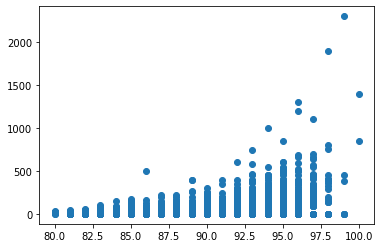

In [53]:
plt.scatter(wineFR['points'], wineFR['price'].apply(int))
plt.show()

The scatter plots aren't showing any definite correlation, even in the subsets, so we can run a Pearson test to confirm this lack of correlation. 

In [54]:
from scipy.stats import pearsonr

In [55]:
corr, _ = pearsonr(wine['points'], wine['price'].apply(int))
print('Pearsons correlation: %.3f' % corr)


Pearsons correlation: 0.390


In [56]:
corr, _ = pearsonr(wineUS['points'], wineUS['price'].apply(int))
print('Pearsons correlation: %.3f' % corr)

Pearsons correlation: 0.448


In [57]:
corr, _ = pearsonr(wineIT['points'], wineIT['price'].apply(int))
print('Pearsons correlation: %.3f' % corr)

Pearsons correlation: 0.499


In [58]:
corr, _ = pearsonr(wineFR['points'], wineFR['price'].apply(int))
print('Pearsons correlation: %.3f' % corr)

Pearsons correlation: 0.331


No correlation here! If our later classification groups are large, we will have to remember that in the minds of the sommeliers, the more expensive bottles aren't neccesarily any tastier than those with more moderate price tags. 

## Text Preparation

We are now ready to begin the classification process, which starts with vectorizing our text field, 'description'. This process has been adapted from (https://www.analyticsvidhya.com/blog/2018/10/stepwise-guide-topic-modeling-latent-semantic-analysis/) **add official ref**

**add more details??**

We start by removing punctuation and numbers, as we are only after the words here. 

In [63]:
wine['clean_desc']=wine['description'].str.replace("[^a-zA-Z#]", " ")

C:\Users\jelin\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [64]:
wine.head()

,id,country,description,designation,points,price,province,region_1,region_2,variety,winery,clean_desc
0,0,United States of America,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz,This tremendous varietal wine hails from ...
1,1,Spain,"Ripe aromas of fig, blackberry and cassis are ...",Carodorum Selección Especial Reserva,96,110,Northern Spain,Toro,NaN,Tinta de Toro,Bodega Carmen Rodríguez,Ripe aromas of fig blackberry and cassis are ...
2,2,United States of America,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley,Mac Watson honors the memory of a wine once ma...
3,3,United States of America,"This spent 20 months in 30% new French oak, an...",Reserve,96,65,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi,This spent months in new French oak an...
4,4,France,"This is the top wine from La Bégude, named aft...",La Brûlade,95,66,Provence,Bandol,NaN,Provence red blend,Domaine de la Bégude,This is the top wine from La B gude named aft...


We can head off some accidental classifications based on words that aren't so meaningful by removing the words that are less than 3 characters as well.

In [65]:
wine['clean_desc'] = wine['clean_desc'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))

C:\Users\jelin\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [66]:
wine.head()

,id,country,description,designation,points,price,province,region_1,region_2,variety,winery,clean_desc
0,0,United States of America,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz,This tremendous varietal wine hails from Oakvi...
1,1,Spain,"Ripe aromas of fig, blackberry and cassis are ...",Carodorum Selección Especial Reserva,96,110,Northern Spain,Toro,NaN,Tinta de Toro,Bodega Carmen Rodríguez,Ripe aromas blackberry cassis softened sweeten...
2,2,United States of America,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley,Watson honors memory wine once made mother thi...
3,3,United States of America,"This spent 20 months in 30% new French oak, an...",Reserve,96,65,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi,This spent months French incorporates fruit fr...
4,4,France,"This is the top wine from La Bégude, named aft...",La Brûlade,95,66,Provence,Bandol,NaN,Provence red blend,Domaine de la Bégude,This wine from gude named after highest point ...


And we will make everything lowercase so the case doesn't effect the later vectorization (such as Ripe and ripe being considered different when we want them treated as the same).

In [67]:
wine['clean_desc'] = wine['clean_desc'].apply(lambda x: x.lower())

C:\Users\jelin\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


We've probably removed quite a few of the stop words in our description field by dint of removing those that are 3 characters or less, but there's still plenty that could skew our classification. Looking above 'this' appears three times, but it certainly wouldn't add any value to our classifications.

In [78]:
#https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize

In [79]:
#tokenizing form https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
stop_words = set(stopwords.words('english'))

In [82]:
word_tokens = word_tokenize(wine['clean_desc'])

TypeError: expected string or bytes-like object

In [83]:
wine.head()

,id,country,description,designation,points,price,province,region_1,region_2,variety,winery,clean_desc
0,0,United States of America,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz,this tremendous varietal wine hails from oakvi...
1,1,Spain,"Ripe aromas of fig, blackberry and cassis are ...",Carodorum Selección Especial Reserva,96,110,Northern Spain,Toro,NaN,Tinta de Toro,Bodega Carmen Rodríguez,ripe aromas blackberry cassis softened sweeten...
2,2,United States of America,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley,watson honors memory wine once made mother thi...
3,3,United States of America,"This spent 20 months in 30% new French oak, an...",Reserve,96,65,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi,this spent months french incorporates fruit fr...
4,4,France,"This is the top wine from La Bégude, named aft...",La Brûlade,95,66,Provence,Bandol,NaN,Provence red blend,Domaine de la Bégude,this wine from gude named after highest point ...


In [87]:
wine.dtypes

id              int64
country        object
description    object
designation    object
points          int64
price          object
province       object
region_1       object
region_2       object
variety        object
winery         object
clean_desc     object
dtype: object

In [89]:
wine['clean_desc'].dropna(inplace=True)
tokens = wine['clean_desc'].apply(word_tokenize)
#https://stackoverflow.com/questions/46105180/typeerror-expected-string-or-bytes-like-object-with-python-nltk-word-tokenize
#user Ekho

In [90]:
filtered_sentence = [w for w in tokens if not w in stop_words] 

TypeError: unhashable type: 'list'

In [94]:
#https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
words = wine['clean_desc'].split() 

filtered_sentence = [] 
  
for w in words: 
    if w not in stop_words: 
        filtered_sentence.append(w) 

AttributeError: 'Series' object has no attribute 'split'

errors from original guide article.

In [69]:
tokenized_doc = wine['clean_desc'].apply(lambda x: x.split())

In [72]:
detokenized_doc = []

In [76]:
for i in range(len(wine)):
    t=' '.join(tokenized_doc[i])
    detokenized_doc.append(t)

KeyError: 300

In [95]:
#tfidf vectorizer removes stopwords already.... 

from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer(stop_words='english', 
max_features= 1000, # keep top 1000 terms 
max_df = 0.5, 
smooth_idf=True)

In [96]:
X = vectorizer.fit_transform(wine['clean_desc'])

In [97]:
X.shape # check shape of the document-term matrix

(97850, 1000)

In [98]:
X

<97850x1000 sparse matrix of type '<class 'numpy.float64'>'
	with 1692723 stored elements in Compressed Sparse Row format>